# Smoothing Spherical Data with Tensor Product Splines
http://link.springer.com/article/10.1007/BF02243776

## Algorithm
### 1. Pseudocode
![image](ssi.png)

### 2. Algorithm Code

In [10]:
from scipy.interpolate import SmoothSphereBivariateSpline
import numpy as np
def ssi(E, P, s):
    try:
        F = SmoothSphereBivariateSpline(P[:, 0], P[:, 1],
                                        E, s=s)
    except:
        F = None
    return F

In [11]:
theta = np.linspace(0., np.pi, 1000)
phi = np.linspace(0., 2*np.pi, 1000)
P = np.column_stack([theta, phi])
E = np.random.normal(0, 1, 1000)
F = ssi(E, P, 2000)

### 3. Conditions for success
This algorithm should work successfully when there are many data points (e.g. many channels in the temporal case), the interpolated regions are close to dense regions of channels, and when many of the channels are correlated with eachother, especially when nearby channels are correlated with eachother.

### 4. Two data sets
1. We will use the EEG data set from our project.
  * I think the algorithm will do relatively bad on this data set, since we are projecting points on the sphere so errors may be introduced.
2. We will use the global temperature dataset from Berkeley Earth.
  * We expect this to work well because the earth is a near perfect sphere and the points are very dense in this data set.

### 5. Data set descriptions
1. EEG Data
  * Real valued data matrix with C=111 channels and T=170,000 timesteps. Measured in microVolts. Each channel has coordinates in spherical coordinates on a head-shaped surface.
  
2. World Data
  * Real valued data matrix with C=5080 channels and T=600 timesteps. Measured in degrees celsius. Each channel has spherical coordinates with r=1 constant throughout (surface is exactly a sphere).

### 6. Plot raw data

In [12]:
import pandas as pd
import cufflinks as cf
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import (download_plotlyjs,
                            init_notebook_mode,
                            plot,
                            iplot)

def plot_sinusoids(D, title):
    pd.DataFrame(data = D.T).iplot(kind='lines',
                                 title=title,
                                 xTitle='time',
                                 yTitle='amplitude')
def plot_3d(lat_v, long_v):
    x, y, z = get_cartesian(lat_v, long_v)

    data = go.Scatter3d(
        x=x,
        y=y,
        z=z,
        mode='markers',
        marker = dict(size=3)
        
    )
    layout = go.Layout(
        title='Channel Positions on Sphere'
    )
    fig = go.Figure(data=[data], layout=layout)
    iplot(fig, filename='simple-3d-scatter')
def get_cartesian(lat_v, long_v):
    x = np.sin(lat_v) * np.cos(long_v)
    y = np.sin(lat_v) * np.sin(long_v)
    z = np.cos(lat_v)
    return x, y, z

In [4]:
import numpy as np
from netCDF4 import Dataset
my_example_nc_file = 'Complete_TAVG_EqualArea.nc'
fh = Dataset(my_example_nc_file, mode='r')
earth = np.array(fh.variables['temperature'][:].T)[:, -600:]
earth_lon = np.array(fh.variables['longitude'][:])
earth_lat = np.array(fh.variables['latitude'][:])
plot_3d((earth_lat + 90) * np.pi / 180, (earth_lon + 180) * np.pi / 180)
def plot_heat(M, title):
    data = [
        go.Heatmap(
            z = M
        )
    ]
    layout = go.Layout(
        title = title
    )
    fig = go.Figure(data=data, layout=layout)
    iplot(fig)
plot_heat(earth[::10, :], 'Temperature of regions over time')

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:5: RuntimeWarning:

invalid value encountered in less

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:5: RuntimeWarning:

invalid value encountered in greater



In [14]:
import h5py
data = h5py.File('test1.mat', 'r')
eeg_data = np.array(data['result']['data'])
base = data['result']['chanlocs']
x = [base[e[0]][:][0][0] for e in base['X']] 
y = [base[e[0]][:][0][0] for e in base['Y']]
z = [base[e[0]][:][0][0] for e in base['Z']] 
data = go.Scatter3d(
        x=x,
        y=y,
        z=z,
        mode='markers',
        marker = dict(size=3)
        
    )
layout = go.Layout(
    title='EEG Channel Positions on Head Cap'
)
fig = go.Figure(data=[data], layout=layout)
iplot(fig, filename='simple-3d-scatter')
t = np.array([base[e[0]][:][0][0] for e in base['sph_theta']]) + 180
p = np.array([base[e[0]][:][0][0] for e in base['sph_phi']]) + 90
r = np.array([base[e[0]][:][0][0] for e in base['sph_radius']])
plot_3d(p, t)
plot_heat(eeg_data.T[:, ::100], 'microVoltage of Channels over time')

### 7. Expectations
We expect the algorithm to run pretty well in each instance, however the Earth data should definitely outperform the EEG data because it has more data points, varies more slowly, and does not go through significant amplitude changes (low frequency).

### Generate toy simulation data

### 1. Sampling distributions
* Good case (simulation A)
For the good case, we will sample $m$ sinusiodal functions such that our samples are highly correlated.
We implement this as follows:
We are sampling $m$ functions of the form:
$$
y = A sin(\theta + x)
$$
where $A$ and $\theta$ are the parameters.
For the case which should perform well (case A) we sample $A \sim normal(1, \sigma_A)$ and $\theta \sim normal(0, \sigma_\theta)$ for $\sigma_A = 0.2, \sigma_\theta = \frac{\pi}{16}$.
We take $m = 111$ of such samples, then take $n = 3000$ evenly spaced (with frequency of 500 samples per second as consistent with our EEG data).
We place each of these in a random location on a sphere.

* Bad case (simulation B)
For the bad case, we will sample $m$ sinusiodal functions such that our samples are not highly correlated.
We implement this as follows:
We are sampling $m$ functions of the form:
$$
y = A sin(\theta + x)
$$
where only $A$ and $\theta$ are the parameters.
For the case which should perform well (case A) we sample $A \sim uniform(0, 2)$ and $\theta \sim uniform(0, 2 \pi)$
We take $m = 111$ of such samples, then take $n = 3000$ evenly spaced (with frequency of 500 samples per second as consistent with our EEG data).
We place each of these in a random location on a sphere.

We will then delete a small subset of the points then interpolate them (3 to 5). We know the correct answer, so we can compare.


### 2. Code to sample

In [15]:
import numpy as np
m = 111
n = 2000
A_rng = (0,2)
th_rng = (0,2 * np.pi)

def get_gaussian_sinusoids(m, n, sig_th, sig_A):
    A_v = np.random.normal(1, sig_A, m)
    th_v = np.random.normal(0, sig_th, m)
    lat_v = np.random.uniform(-90, 90, m)
    long_v = np.random.uniform(-180, 180, m)
    base = np.vstack([np.sin(np.linspace(0, 2 * np.pi, n) + th) for th in th_v])
    D_A = A_v.reshape(-1, 1) * base
    return D_A, lat_v, long_v
def get_gaussian_sinusoids2(m, n, A_rng, th_rng):
    lA, rA = A_rng
    lT, rT = th_rng
    A_v = np.random.uniform(lA, rA, m)
    th_v = np.random.uniform(lT, rT, m)
    lat_v = np.random.uniform(-90, 90, m)
    long_v = np.random.uniform(-180, 180, m)
    base = np.vstack([np.sin(np.linspace(0, 2 * np.pi, n) + th) for th in th_v])
    D_A = A_v.reshape(-1, 1) * base
    return D_A, lat_v, long_v

### 3. What should the simulations look like?
* Samples of the sinusoids are expected to look like a collection of 111 sinusoid functions which are not very correlated.

* We should also observe that the randomly selected sinusoid spherical locations are randomly distributed around a sphere.

### 4. Code to plot
(This is already written above, before we plotted the raw real data)

### 5. Plot simulated data

In [16]:
m = 111
n = 2000
sig_th = np.pi / 16
sig_A = 0.2

D, lat, lon = get_gaussian_sinusoids(m, n, sig_th, sig_A)
plot_sinusoids(D, title='Sinusoids Experiment A')
plot_3d(lat, lon)

D, lat, lon = get_gaussian_sinusoids2(m, n, A_rng, th_rng)
plot_sinusoids(D, title='Sinusoids Experiment B')
plot_3d(lat, lon)

### 6. Correctness
These simulations appear to be correct and have the desired properties to showcase success and failure.

## Analyze toy simulation data
### 1. Prediction
* In the easy case (simulation A), the interpolation algorithm should reconstruct the missing signals with high accuracy
* In the hard case (simulation B), the interpolation algorithm should reconstruct the missing signals with much lower accuracy than that measured in the easy case.

### 2. Generate simulated data

In [17]:
m = 111
n = 2000
sig_th = np.pi / 16
sig_A = 0.2
D_A, lat_A, lon_A = get_gaussian_sinusoids(m, n, sig_th, sig_A)
m = 111
n = 2000
A_rng = (0,2)
th_rng = (0,2 * np.pi)
D_B, lat_B, lon_B = get_gaussian_sinusoids2(m, n, A_rng, th_rng)

### 3. Run algorithm on simulated data

In [18]:
coords_A = np.column_stack([lat_A, lon_A, np.zeros(lat_A.shape)])
coords_B = np.column_stack([lat_B, lon_B, np.zeros(lat_B.shape)])
coords_A[:, 0] = (coords_A[:, 1] + 180) / 180.
coords_A[:, 1] = (coords_A[:, 0] + 180) / 180.
coords_B[:, 0] = (coords_B[:, 1] + 180) / 180.
coords_B[:, 1] = (coords_B[:, 0] + 180) / 180.
rand_idx = np.random.choice(np.arange(111),
                            5,
                            replace=False)

def intp(D, coords, rm_idx, s=1000):
    old = D[rand_idx, :]
    samp_idx = np.setdiff1d(np.arange(D.shape[0]), rm_idx)
    sample = D[samp_idx]
    F = []
    for i in range(sample.shape[1]):
        F_i = ssi(sample[:, i],
                  coords[samp_idx],
                  s = s)
        F.append(F_i)
    pred = []
    for idx in rand_idx:
        inpt = []
        for i, f in enumerate(F):
            if f is None:
                inpt.append(D[:, i])
            else:
                inpt.append(f(coords[idx, 0],
                          coords[idx, 1])[0][0])
        pred.append(np.array(inpt))
    return np.array(pred), old

new_A, old_A = intp(D_A, coords_A[:, :2], rand_idx)
new_B, old_B = intp(D_B, coords_B[:, :2], rand_idx)
#print new.shape
pd.DataFrame(data = old_A.T).iplot(kind='line',
                                 title='Gold Standard signals, A',
                                 xTitle='time',
                                 yTitle='amplitude in microVolts')
pd.DataFrame(data = new_A.T).iplot(kind='line',
                                 title='Interpolated signals, A',
                                 xTitle='time',
                                 yTitle='amplitude in microVolts')
pd.DataFrame(data = old_B.T).iplot(kind='line',
                                 title='Gold Standard signals, B',
                                 xTitle='time',
                                 yTitle='amplitude in microVolts')
pd.DataFrame(data = new_B.T).iplot(kind='line',
                                 title='Interpolated signals, B',
                                 xTitle='time',
                                 yTitle='amplitude in microVolts')

### 5. Describe metric
We will use the frobenius norm of the gold data and the interpolated data divided by the number of channels which were interpolated (e.g. the average squared norm) and also divided by the number of the time steps (to normalize for longer sequences).

### 6. Non gold-standard metric
We do not have gold standard data for either real data set, but we can just delete a small number of the channels then interpolate them back. This way we can compare against real data.

### 7. Write code to quantify the results

In [19]:
def metric(old, new):
    n = old.shape[0]
    m = old.shape[1]
    return np.linalg.norm(old - new) / (n * m)

### 8. Quantify performance

In [20]:
print 'Metric simulation A', metric(old_A, new_A)
print 'Metric simulation B', metric(old_B, new_B)

Metric simulation A 0.00217404777723
Metric simulation B 0.00908317538853


### 9/10. Repeat 10x on good and bad cases

In [21]:
for i in range(10):
    m = 111
    n = 2000
    sig_th = np.pi / 16
    sig_A = 0.2
    D_A, lat_A, lon_A = get_gaussian_sinusoids(m, n, sig_th, sig_A)
    m = 111
    n = 2000
    A_rng = (0,2)
    th_rng = (0,2 * np.pi)
    D_B, lat_B, lon_B = get_gaussian_sinusoids2(m, n, A_rng, th_rng)
    coords_A = np.column_stack([lat_A, lon_A, np.zeros(lat_A.shape)])
    coords_B = np.column_stack([lat_B, lon_B, np.zeros(lat_B.shape)])
    coords_A[:, 0] = (coords_A[:, 1] + 180) / 180.
    coords_A[:, 1] = (coords_A[:, 0] + 180) / 180.
    coords_B[:, 0] = (coords_B[:, 1] + 180) / 180.
    coords_B[:, 1] = (coords_B[:, 0] + 180) / 180.
    rand_idx = np.random.choice(np.arange(111),
                                5,
                                replace=False)
    new_A, old_A = intp(D_A, coords_A[:, :2], rand_idx)
    new_B, old_B = intp(D_B, coords_B[:, :2], rand_idx)
    print 'Iteration', i
    print '  Metric , simulation A', metric(old_A, new_A)
    print '  Metric simulation B', metric(old_B, new_B)

Iteration 0
  Metric , simulation A 0.00175056768166
  Metric simulation B 0.00873203814054
Iteration 1
  Metric , simulation A 0.00221041890051
  Metric simulation B 0.00569433690359
Iteration 2
  Metric , simulation A 0.00173150116796
  Metric simulation B 0.00771394301112
Iteration 3
  Metric , simulation A 0.00170139280922
  Metric simulation B 0.00739818399786
Iteration 4
  Metric , simulation A 0.00159906367826
  Metric simulation B 0.00887662978832
Iteration 5
  Metric , simulation A 0.0025188045851
  Metric simulation B 0.00835031392585
Iteration 6
  Metric , simulation A 0.00193438184555
  Metric simulation B 0.00720281883581
Iteration 7
  Metric , simulation A 0.00184013181511
  Metric simulation B 0.00504754549578
Iteration 8
  Metric , simulation A 0.00229504849201
  Metric simulation B 0.00910777823324
Iteration 9
  Metric , simulation A 0.00203028410223
  Metric simulation B 0.00808307727746


## Summarize toy simulation analysis
### 1. Describe how you will visualize the population results
We will visualize the population results as a histogram of the metric described in the previous section.
### 2. Describe how you will compute population performance
We will calculate the mean of the values used to create the histogram as the quantitative evaluation
### 3. Write code to plot population results

In [22]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_population(A, title, xtitle, ytitle):
    sns.distplot(A)
    plt.title(title)
    plt.xlabel(xtitle)
    plt.ylabel(ytitle)
    plt.show()

### 4. Code to compute population performance


In [23]:
def population_performance(A):
    return np.mean(A)

### 5. Run qualitative analysis on both cases (100 times)

In [24]:
A = []
B = []
for i in range(100):
    m = 111
    n = 2000
    sig_th = np.pi / 16
    sig_A = 0.2
    D_A, lat_A, lon_A = get_gaussian_sinusoids(m, n, sig_th, sig_A)
    m = 111
    n = 2000
    A_rng = (0,2)
    th_rng = (0,2 * np.pi)
    D_B, lat_B, lon_B = get_gaussian_sinusoids2(m, n, A_rng, th_rng)
    coords_A = np.column_stack([lat_A, lon_A, np.zeros(lat_A.shape)])
    coords_B = np.column_stack([lat_B, lon_B, np.zeros(lat_B.shape)])
    coords_A[:, 0] = (coords_A[:, 1] + 180) / 180.
    coords_A[:, 1] = (coords_A[:, 0] + 180) / 180.
    coords_B[:, 0] = (coords_B[:, 1] + 180) / 180.
    coords_B[:, 1] = (coords_B[:, 0] + 180) / 180.
    rand_idx = np.random.choice(np.arange(111),
                                5,
                                replace=False)
    new_A, old_A = intp(D_A, coords_A[:, :2], rand_idx)
    new_B, old_B = intp(D_B, coords_B[:, :2], rand_idx)
    A.append(metric(old_A, new_A))
    B.append(metric(old_B, new_B))

### Plot qualitative analysis on both cases

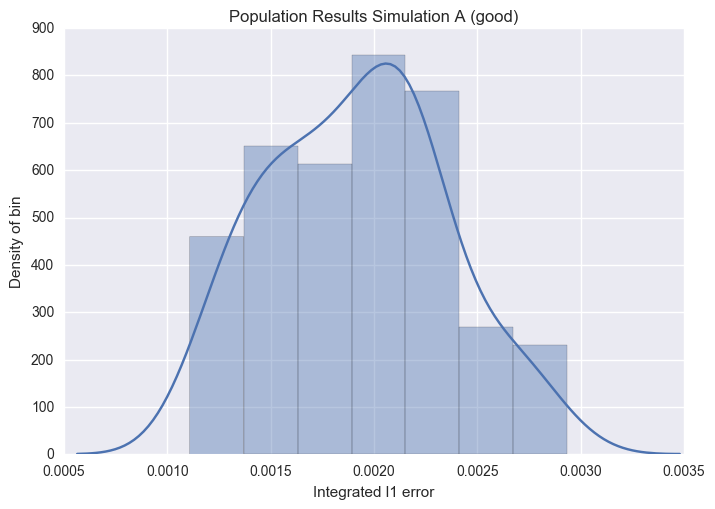

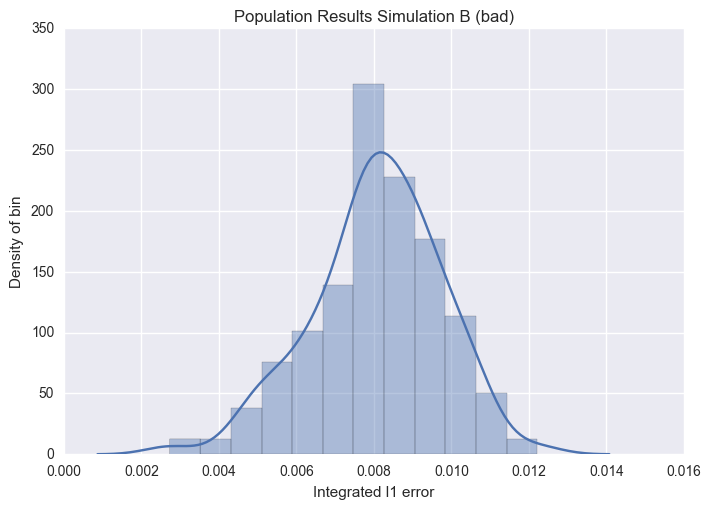

In [25]:
A = np.array(A)
plot_population(A,
                'Population Results Simulation A (good)',
                'Integrated l1 error',
                'Density of bin')
B = np.array(B)
plot_population(B,
                'Population Results Simulation B (bad)',
                'Integrated l1 error',
                'Density of bin')

### 6. Run quantitative population analysis

In [26]:
print 'The mean error for simulation A was: ', population_performance(A)
print 'The mean error for simulation B was: ', population_performance(B)

The mean error for simulation A was:  0.00191731912501
The mean error for simulation B was:  0.0080738656513


### 7. ...completed in parallel...
### 8. sumarize performance
As expected, the performance was better for the 'good' case (e.g. simulation A) and was worse on the 'bad'  (e.g. simulation B). This difference was not extreme however, and the difference was only about a factor of 3 rather than orders of magnitude.

# Real Data Analysis
## Synthetic Data Analysis
### 1. describe how you willl simulate the raw data
We will simulate the raw data by using the same data generation function used in part A, except we will have 111 channels and will have 170,000 timesteps, as consistent with the real data. We will have much higher frequency for these simulations.

We will delete then interpolate 5 channels for testing.

### 2. Synthetic raw data plot

In [27]:
def get_gaussian_sinusoids3(m, n, sig_th, sig_A):
    A_v = np.random.normal(1, sig_A, m)
    th_v = np.random.normal(0, sig_th, m)
    lat_v = np.random.uniform(-90, 90, m)
    long_v = np.random.uniform(-180, 180, m)
    base = np.vstack([np.sin(3 * np.linspace(0, 2 * np.pi, n) + th) for th in th_v])
    D_A = A_v.reshape(-1, 1) * base
    return D_A, lat_v, long_v

m = 111
n = 170000
sig_th = np.pi / 8
sig_A = .2

D, lat, lon = get_gaussian_sinusoids3(m, n, sig_th, sig_A)
plot_sinusoids(D[:, ::100], title='Sinusoids Experiment A')
plot_3d(lat, lon)

### 3. Expectations
This algorithm should work similarly to the simulation data used above, e.g. it should interpolate with low error.

### 4. Wrapper function
(Written above in the intp function)

### 5. Call function using synthetic data.

In [28]:
coords = np.column_stack([lat, lon, np.zeros(lat.shape)])
coords[:, 0] = (coords[:, 1] + 180) / 180.
coords[:, 1] = (coords[:, 0] + 180) / 180.
rand_idx = np.random.choice(np.arange(111),
                            5,
                            replace=False)
new, old = intp(D, coords[:, :2], rand_idx, s=100000)

### 6. Generate plots to verify synthetic dataset works

In [29]:
pd.DataFrame(data = old[:, ::100].T).iplot(kind='line',
                                 title='Gold Standard signals',
                                 xTitle='time',
                                 yTitle='amplitude in microVolts')
pd.DataFrame(data = new[:, ::100].T).iplot(kind='line',
                                 title='Interpolated signals',
                                 xTitle='time',
                                 yTitle='amplitude in microVolts')

## Real Data Analysis

### 1. Predict performance accuracy
* EEG data
  * The algorithm should work relatively well on this data set. Results may be worse than the next example because points did not originally come from a sphere.
  
* Earth data
  * The algorithm should work quite well on this data set because points are far more dense on the sphere, and the data actually comes from a sphere (or a much closer approximation to one).

### 2. Run same code on real data

#### EEG data

In [30]:
coords = np.column_stack([t, p, np.zeros(lat.shape)])
coords[:, 0] = (coords[:, 1] + 180) / 180.
coords[:, 1] = (coords[:, 0] + 180) / 180.
rand_idx = np.random.choice(np.arange(111),
                            5,
                            replace=False)
new, old = intp(eeg_data.T, coords[:, :2], rand_idx, s=100000)

In [31]:
pd.DataFrame(data = old[:, ::100].T).iplot(kind='line',
                                 title='Gold Standard signals',
                                 xTitle='time',
                                 yTitle='amplitude in microVolts')
pd.DataFrame(data = new[:, ::100].T).iplot(kind='line',
                                 title='Interpolated signals',
                                 xTitle='time',
                                 yTitle='amplitude in microVolts')
print 'EEG Data metric', metric(new, old)

EEG Data metric 0.00691243746657


#### Earth Data

In [32]:
coords = np.column_stack([earth_lat, earth_lon, np.zeros(earth_lat.shape)])
coords[:, 0] = (coords[:, 1] + 180) / 180.
coords[:, 1] = (coords[:, 0] + 180) / 180.
rand_idx = np.random.choice(np.arange(111),
                            5,
                            replace=False)
new, old = intp(earth, coords[:, :2], rand_idx, s=100000)

In [33]:
pd.DataFrame(data = old.T).iplot(kind='line',
                                 title='Gold Standard signals',
                                 xTitle='time',
                                 yTitle='amplitude in degrees celsius')
pd.DataFrame(data = new.T).iplot(kind='line',
                                 title='Interpolated signals',
                                 xTitle='time',
                                 yTitle='amplitude in degrees celsius')
print 'Earth Data metric', metric(new, old)

Earth Data metric 0.0425976527943


### 3. Document performance
Both data sets worked very well on the simulations. Surprisingly, it appears that the EEG data set actually worked better than the earth data set. It could be because the Earth data is not as highly correlated (different temperature regions) and that the EEG data is.

### 4. Prediction on future data sets
This algorithm seems well implemented and robust. It seems to do a very good job on real world data sets, seemingly even better than the simulated data sets that we input. This could be because naturally these data sets will have continuous functions on the surface of the sphere, while the simulated data sets may have some problems with continuity. 

### 5. Improve performance
There is one hyperparameter, the smoothing value. To improve performance, it could be helpful to do some sort of cross validation hyperparameter search to find the best value for this parameter. This should be relatively easy to do because the algorithm runs extremely quickly.